Assignment 4 - ADM - Team 2: Anvesh Varma Vatsavai, 
Vishnu Teja Paklapati

In [1]:
import tensorflow as tf
from tensorflow.keras.applications.vgg19 import preprocess_input
from tensorflow.keras.models import Model
print(tf.__version__)

import matplotlib.pyplot as plt
plt.rcParams.update({'pdf.fonttype': 'truetype'})
from matplotlib import offsetbox
import numpy as np
from tqdm import tqdm

import glob
import ntpath
import cv2

from sklearn.metrics.pairwise import cosine_similarity
from sklearn import manifold
import scipy as sc

2.8.0


In [6]:
import pickle

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


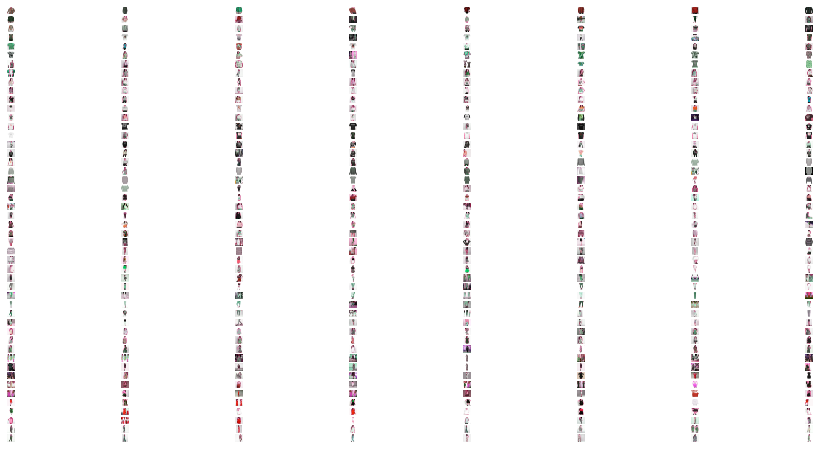

In [3]:
image_paths = glob.glob('/content/drive/MyDrive/ADM/*.jpg')
images = {}

for image_path in image_paths:
  image = cv2.imread(image_path, 3)
  g, b, r = cv2.split(image) # get b, g, r
  image = cv2.merge([r,g,b]) # switch it to r, g, b
  image = cv2.resize(image, (200, 200))
  images[ntpath.basename(image_path)] = image
  
n_col = 8
n_row = int(len(images)/n_col)
f, ax = plt.subplots(n_row, n_col, figsize=(16, 8))
for i in range(n_row):
  for j in range(n_col):
    ax[i, j].imshow(list(images.values())[n_col*i + j])
    ax[i, j].set_axis_off()

In [4]:
filename = 'images.pickle'
outfile = open(filename, 'wb')

In [7]:
filename = 'images.pickle'

with open(filename,'wb') as pickle_file:

  pickle.dump(images, pickle_file)

  outfile.close()

In [8]:
infile = open(filename,'rb')

new_dict1 = pickle.load(infile)

infile.close()

In [9]:
print(new_dict1)

{'img_000000380.jpg': array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
  

In [ ]:
image_paths[0]

Compute and visualize style embeddings

In [10]:
def load_image(image):
    image = plt.imread(image)
    img = tf.image.convert_image_dtype(image, tf.float32)
    img = tf.image.resize(img, [400, 400])
    img = img[tf.newaxis, :] # shape -> (batch_size, h, w, d)
    return img

#
# content layers describe the image subject
#
content_layers = ['block5_conv2'] 

#
# style layers describe the image style
# we exclude the upper level layes to focus on small-size style details
#
style_layers = [ 
        'block1_conv1',
        'block2_conv1',
        'block3_conv1', 
        #'block4_conv1', 
        #'block5_conv1'
    ] 

def selected_layers_model(layer_names, baseline_model):
    outputs = [baseline_model.get_layer(name).output for name in layer_names]
    model = Model([vgg.input], outputs)
    return model

# style embedding is computed as concatenation of gram matrices of the style layers
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

class StyleModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleModel, self).__init__()
        self.vgg =  selected_layers_model(style_layers + content_layers, vgg)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        # scale back the pixel values
        inputs = inputs*255.0
        # preprocess them with respect to VGG19 stats
        preprocessed_input = preprocess_input(inputs)
        # pass through the reduced network
        outputs = self.vgg(preprocessed_input)
        # segregate the style and content representations
        style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                          outputs[self.num_style_layers:])

        # calculate the gram matrix for each layer
        style_outputs = [gram_matrix(style_output) for style_output in style_outputs]

        # assign the content representation and gram matrix in
        # a layer by layer fashion in dicts
        content_dict = {content_name:value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}

vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

def image_to_style(image_tensor):
    extractor = StyleModel(style_layers, content_layers)
    return extractor(image_tensor)['style']

def style_to_vec(style):
    # concatenate gram matrics in a flat vector
    return np.hstack([np.ravel(s) for s in style.values()]) 

#
# Print shapes of the style layers and embeddings
#
image_tensor = load_image(image_paths[0])
style_tensors = image_to_style(image_tensor)
for k,v in style_tensors.items():
    print(f'Style tensor {k}: {v.shape}')
style_embedding = style_to_vec( style_tensors )
print(f'Style embedding: {style_embedding.shape}')

#
# compute styles
#
image_style_embeddings = {}
for image in tqdm(image_paths): 
    image_tensor = load_image(image)
    style = style_to_vec( image_to_style(image_tensor) )
    image_style_embeddings[ntpath.basename(image)] = style

80150528/80134624 [==============================] - 1s 0us/step
Style tensor block1_conv1: (1, 64, 64)
Style tensor block2_conv1: (1, 128, 128)
Style tensor block3_conv1: (1, 256, 256)
Style embedding: (86016,)


100%|██████████| 395/395 [13:58<00:00,  2.12s/it]


In [11]:
filename = 'image_style_embeddings_subset.pickle'
outfile = open(filename, 'wb')

In [12]:
filename = 'image_style_embeddings_subset.pickle'

with open(filename,'wb') as pickle_file:

  pickle.dump(image_style_embeddings, pickle_file)

  outfile.close()

In [13]:
infile = open(filename,'rb')

new_dict1 = pickle.load(infile)

infile.close()

In [ ]:
print(new_dict1)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


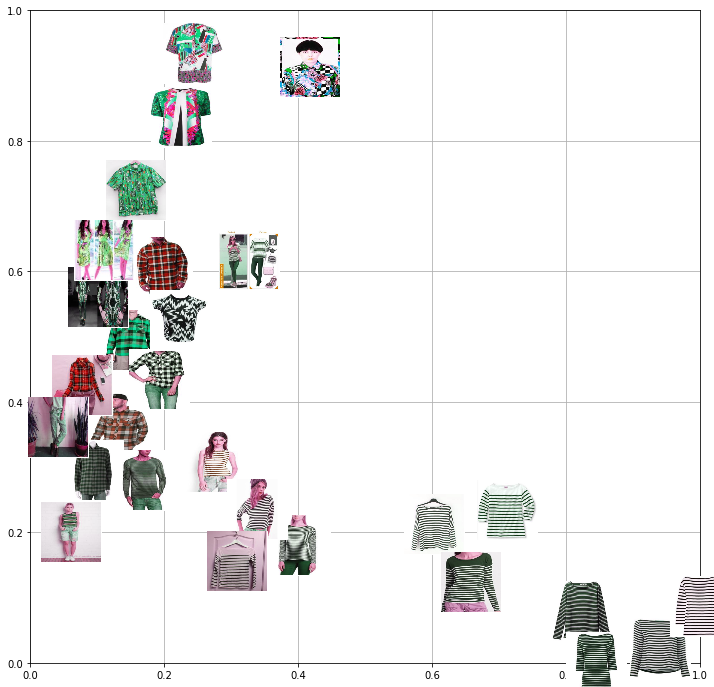

In [14]:
#
# Visualize the 2D-projection of the embedding space with example images (thumbnails)
#
def embedding_plot(X, images, thumbnail_sparsity = 0.005, thumbnail_size = 0.3):
    x_min, x_max = np.min(X, axis=0), np.max(X, axis=0)
    X = (X - x_min) / (x_max - x_min)
    fig, ax = plt.subplots(1, figsize=(12, 12))

    shown_images = np.array([[1., 1.]])
    for i in range(X.shape[0]):
        if np.min(np.sum((X[i] - shown_images) ** 2, axis=1)) < thumbnail_sparsity: continue
        shown_images = np.r_[shown_images, [X[i]]]
        thumbnail = offsetbox.OffsetImage(images[i], cmap=plt.cm.gray_r, zoom=thumbnail_size)
        ax.add_artist(offsetbox.AnnotationBbox(thumbnail, X[i], bboxprops = dict(edgecolor='white'), pad=0.0))

    plt.grid(True)
    
tsne = manifold.TSNE(n_components=2, init='pca', perplexity=10, random_state=0)
X_tsne = tsne.fit_transform( np.array(list(image_style_embeddings.values())) )
embedding_plot(X_tsne, images=list(images.values()))

dict_keys(['01_1_front.jpg', '01_7_additional.jpg', '01_2_side.jpg', '01_3_back.jpg', '04_1_front.jpg', '18_2_side.jpg', '05_2_side.jpg', '04_6_flat.jpg', '01_6_flat.jpg', '03_6_flat.jpg', '05_1_front.jpg', '15_2_side.jpg', '18_1_front.jpg', '15_1_front.jpg', '17_1_front.jpg', '17_3_back.jpg', '04_7_additional.jpg', '03_2_side.jpg', '05_3_back.jpg', '15_3_back.jpg', '04_2_side.jpg', '15_4_full.jpg', '03_3_back.jpg', '17_2_side.jpg', '15_6_flat.jpg', '03_1_front.jpg', '17_4_full.jpg', '05_7_additional.jpg', '04_3_back.jpg', '05_6_flat.jpg', '03_7_additional.jpg', '18_4_full.jpg', '45_3_back.jpg', '46_7_additional.jpg', '08_4_full.jpg', '45_2_side.jpg', '29_2_side.jpg', '44_7_additional.jpg', '08_1_front.jpg', '46_3_back.jpg', '28_2_side.jpg', '28_3_back.jpg', '27_1_front.jpg', '18_7_additional.jpg', '27_3_back.jpg', '44_2_side.jpg', '29_1_front.jpg', '46_2_side.jpg', '08_6_flat.jpg', '44_1_front.jpg', '46_1_front.jpg', '28_7_additional.jpg', '08_3_back.jpg', '18_3_back.jpg', '26_2_side.

Search in Embeddings

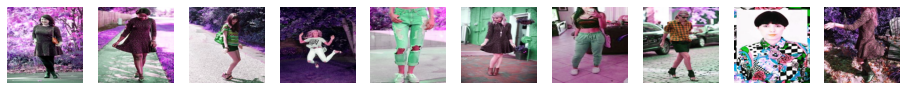

In [16]:
def search_by_style(image_style_embeddings, images, reference_image, max_results=10):
    v0 = image_style_embeddings[reference_image]
    distances = {}
    for k,v in image_style_embeddings.items():
        d = sc.spatial.distance.cosine(v0, v)
        distances[k] = d

    sorted_neighbors = sorted(distances.items(), key=lambda x: x[1], reverse=False)
    image_list = []
    f, ax = plt.subplots(1, max_results, figsize=(16, 8))
    for i, img in enumerate(sorted_neighbors[:max_results]):
        ax[i].imshow(images[img[0]])
        ax[i].set_axis_off()
        image_list.append(img[0])
      

    plt.show()
    return image_list

# images mostly match the reference style, although not perfectly

input_image_path = 'img_00000001.jpg'

image_list = search_by_style(image_style_embeddings, images, input_image_path)
di = {input_image_path:image_list}

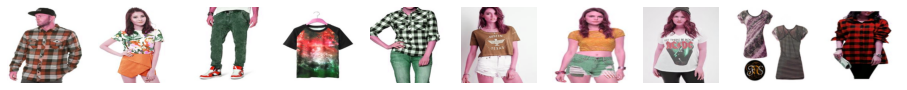

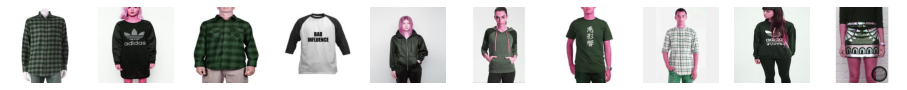

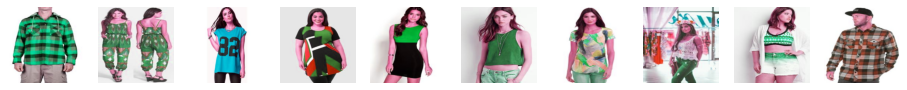

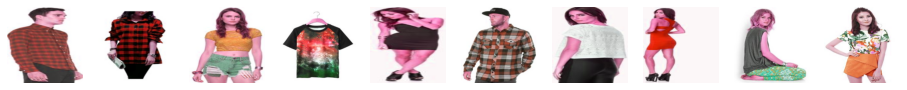

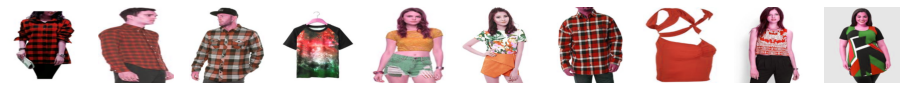

...

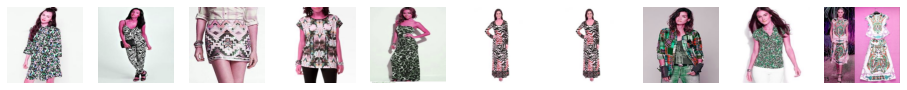

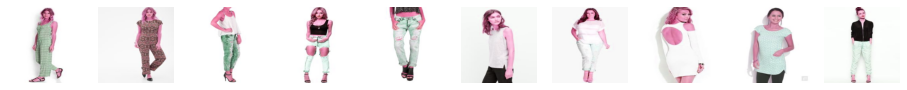

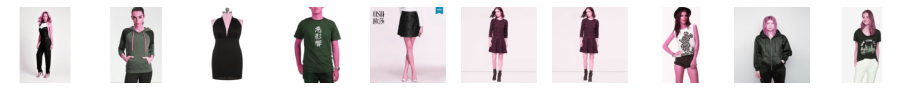

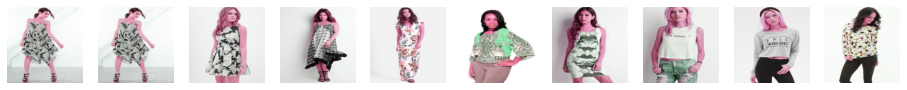

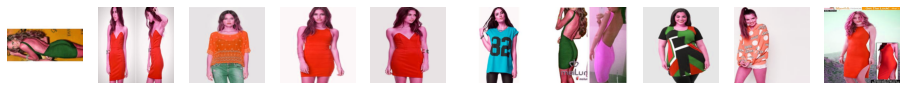

In [17]:
image_l = {}
for image in image_style_embeddings.keys():
     image_list = search_by_style(image_style_embeddings, images, image)
     image_l[image] = (image_list)

In [18]:
import json
with open("sample.json", "w") as outfile:
    json.dump(image_l, outfile)

In [19]:
len(image_style_embeddings)

395